In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import datetime as dt
from pathlib import Path
from functools import reduce
import scipy

In [2]:
path = Path(r"C:\Users\stapi\My projects\Stock analysis\stock_prices")

In [3]:
path_list = sorted(path.glob('*.csv'))

In [4]:
names = []
for i, csv_file in enumerate(path_list):
    names.append(f"stock_{i}")
    globals()[f'stock_{i}'] = pd.read_csv(path_list[i], parse_dates=["Date"], usecols=["Date", "Volume"])
    name = str(path_list[i]).split("\\")[-1].split('.')[0]
    stock_name = f'({name}) Volume'
    globals().get(names[i]).columns = ["Date", stock_name]
    # data.columns = ["Date", stock_name]

print(names)

['stock_0', 'stock_1', 'stock_2', 'stock_3', 'stock_4', 'stock_5', 'stock_6', 'stock_7', 'stock_8', 'stock_9', 'stock_10', 'stock_11', 'stock_12', 'stock_13', 'stock_14', 'stock_15', 'stock_16', 'stock_17', 'stock_18', 'stock_19', 'stock_20', 'stock_21', 'stock_22', 'stock_23', 'stock_24', 'stock_25', 'stock_26', 'stock_27', 'stock_28', 'stock_29', 'stock_30', 'stock_31', 'stock_32', 'stock_33', 'stock_34', 'stock_35', 'stock_36', 'stock_37', 'stock_38', 'stock_39', 'stock_40', 'stock_41', 'stock_42', 'stock_43', 'stock_44', 'stock_45', 'stock_46', 'stock_47', 'stock_48', 'stock_49', 'stock_50', 'stock_51', 'stock_52', 'stock_53', 'stock_54', 'stock_55', 'stock_56', 'stock_57', 'stock_58', 'stock_59', 'stock_60', 'stock_61', 'stock_62', 'stock_63', 'stock_64', 'stock_65', 'stock_66', 'stock_67', 'stock_68', 'stock_69', 'stock_70', 'stock_71', 'stock_72', 'stock_73', 'stock_74', 'stock_75', 'stock_76', 'stock_77', 'stock_78', 'stock_79', 'stock_80', 'stock_81', 'stock_82', 'stock_83', '

In [5]:
globals()['stock_0'].head()

,Date,(A) Volume
0,1999-11-18,62546380.0
1,1999-11-19,15234146.0
2,1999-11-22,6577870.0
3,1999-11-23,5975611.0
4,1999-11-24,4843231.0


In [6]:
globals()[names[0]].merge(globals()[names[1]], how="inner", on="Date") #Testing to see if joining globals() dataframes works.

,Date,(A) Volume,(AAL) Volume
0,2005-09-27,3930197.0,961200.0
1,2005-09-28,3909227.0,5747900.0
2,2005-09-29,8579666.0,1078200.0
3,2005-09-30,6801130.0,3123300.0
4,2005-10-03,6663847.0,1057900.0
...,...,...,...
4329,2022-12-07,1011100.0,28161400.0
4330,2022-12-08,1289900.0,25300900.0
4331,2022-12-09,1020200.0,18489800.0
4332,2022-12-12,1071400.0,23344600.0


In [7]:
dfs = [globals().get(names[i]) for i in range(len(names))]

In [38]:
final_df = reduce(lambda left,right: pd.merge(left,right, on=["Date"], how="outer"), dfs)

In [42]:
final_df.fillna(0, inplace=True)

In [43]:
final_df.sort_values(by="Date")

,Date,(A) Volume,(AAL) Volume,(AAP) Volume,(AAPL) Volume,(ABBV) Volume,(ABC) Volume,(ABMD) Volume,(ABT) Volume,(ACGL) Volume,...,(WYNN) Volume,(XEL) Volume,(XOM) Volume,(XRAY) Volume,(XYL) Volume,(YUM) Volume,(ZBH) Volume,(ZBRA) Volume,(ZION) Volume,(ZTS) Volume
10779,1962-01-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,902400,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10780,1962-01-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10781,1962-01-04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1088000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10782,1962-01-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1222400,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10783,1962-01-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1388800,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5800,2022-12-07,1011100.0,28161400.0,1516900.0,69721100.0,4637800.0,1224400.0,974100.0,3592400.0,1853200.0,...,1783900.0,2659400.0,20061700,1545400.0,460500.0,2085600.0,1810000.0,303100.0,1994400.0,2444100.0
5801,2022-12-08,1289900.0,25300900.0,773000.0,62128300.0,4274400.0,882200.0,1506900.0,4607700.0,2142900.0,...,2800300.0,2160600.0,21128800,1354400.0,518100.0,1500000.0,1814100.0,473400.0,1166600.0,2267500.0
5802,2022-12-09,1020200.0,18489800.0,831400.0,76069500.0,4644200.0,2979500.0,990100.0,5345400.0,1561000.0,...,2056100.0,3793100.0,21285200,1185600.0,1128500.0,1833800.0,1449200.0,551900.0,900700.0,3274900.0
5803,2022-12-12,1071400.0,23344600.0,868300.0,70462700.0,4109400.0,1401700.0,1317700.0,4752500.0,2142200.0,...,1924800.0,1967300.0,20413200,1416700.0,876500.0,1361700.0,1737000.0,478500.0,1172300.0,1851800.0


In [46]:
pivoted = final_df.set_index("Date").sort_index()
pivoted.head()

,(A) Volume,(AAL) Volume,(AAP) Volume,(AAPL) Volume,(ABBV) Volume,(ABC) Volume,(ABMD) Volume,(ABT) Volume,(ACGL) Volume,(ACN) Volume,...,(WYNN) Volume,(XEL) Volume,(XOM) Volume,(XRAY) Volume,(XYL) Volume,(YUM) Volume,(ZBH) Volume,(ZBRA) Volume,(ZION) Volume,(ZTS) Volume
Date,,,,,,,,,,,,,,,,,,,,,
1962-01-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,902400,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1962-01-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1962-01-04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1088000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1962-01-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1222400,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1962-01-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1388800,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [52]:
values = final_df.columns[1:,]
values

Index(['(A) Volume', '(AAL) Volume', '(AAP) Volume', '(AAPL) Volume',
       '(ABBV) Volume', '(ABC) Volume', '(ABMD) Volume', '(ABT) Volume',
       '(ACGL) Volume', '(ACN) Volume',
       ...
       '(WYNN) Volume', '(XEL) Volume', '(XOM) Volume', '(XRAY) Volume',
       '(XYL) Volume', '(YUM) Volume', '(ZBH) Volume', '(ZBRA) Volume',
       '(ZION) Volume', '(ZTS) Volume'],
      dtype='object', length=502)

In [88]:
final_df[values].max()

(A) Volume       6.254638e+07
(AAL) Volume     4.286171e+08
(AAP) Volume     1.974950e+07
(AAPL) Volume    7.421641e+09
(ABBV) Volume    1.227402e+08
                     ...     
(YUM) Volume     5.110631e+07
(ZBH) Volume     1.318647e+07
(ZBRA) Volume    1.786320e+07
(ZION) Volume    2.633310e+07
(ZTS) Volume     6.678910e+07
Length: 502, dtype: float64

In [89]:
final_df[values].min()

(A) Volume       0.0
(AAL) Volume     0.0
(AAP) Volume     0.0
(AAPL) Volume    0.0
(ABBV) Volume    0.0
                ... 
(YUM) Volume     0.0
(ZBH) Volume     0.0
(ZBRA) Volume    0.0
(ZION) Volume    0.0
(ZTS) Volume     0.0
Length: 502, dtype: float64

In [105]:
std_volumes = pd.DataFrame(final_df[values].std(), columns=["Standard Deviation"]).reset_index()
std_volumes.head()

,index,Standard Deviation
0,(A) Volume,2.246965e+06
1,(AAL) Volume,1.335386e+07
2,(AAP) Volume,7.905302e+05
3,(AAPL) Volume,3.190959e+08
4,(ABBV) Volume,3.564789e+06


In [106]:
stock_volume_means = pd.DataFrame(final_df[values].mean(), columns=["Mean Values"]).reset_index()
stock_volume_means.head()

,index,Mean Values
0,(A) Volume,1.307300e+06
1,(AAL) Volume,4.064475e+06
2,(AAP) Volume,4.049599e+05
3,(AAPL) Volume,2.263570e+08
4,(ABBV) Volume,1.268901e+06


In [107]:
merged_df = std_volumes.merge(stock_volume_means, how='inner', on='index')
merged_df.head()

,index,Standard Deviation,Mean Values
0,(A) Volume,2.246965e+06,1.307300e+06
1,(AAL) Volume,1.335386e+07,4.064475e+06
2,(AAP) Volume,7.905302e+05,4.049599e+05
3,(AAPL) Volume,3.190959e+08,2.263570e+08
4,(ABBV) Volume,3.564789e+06,1.268901e+06


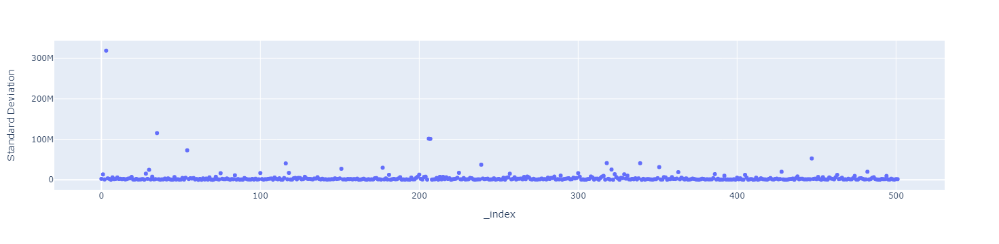

In [109]:
fig = px.scatter(merged_df, x=merged_df.index, y="Standard Deviation")

fig.show()

In [135]:
unicorns = merged_df[merged_df["Standard Deviation"].ge(40000000)]
list_unicorns = list(unicorns["index"])

In [147]:
all_unicorns = final_df[['Date','(AAPL) Volume','(AMZN) Volume','(BAC) Volume','(CSCO) Volume','(GOOG) Volume','(GOOGL) Volume','(MSFT) Volume','(NVDA) Volume','(TSLA) Volume']].sort_values(by="Date")
all_unicorns = all_unicorns[all_unicorns["Date"].dt.year >= 1973]

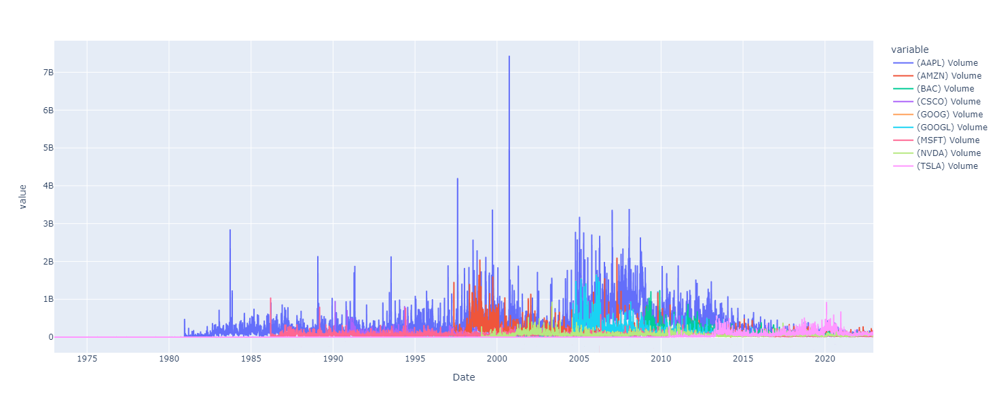

In [148]:
fig = px.line(all_unicorns, x="Date", y=list_unicorns, height=600)

fig.show()

In [152]:
apple_path = path_list[3]
apple_data = pd.read_csv(apple_path, parse_dates=["Date"])

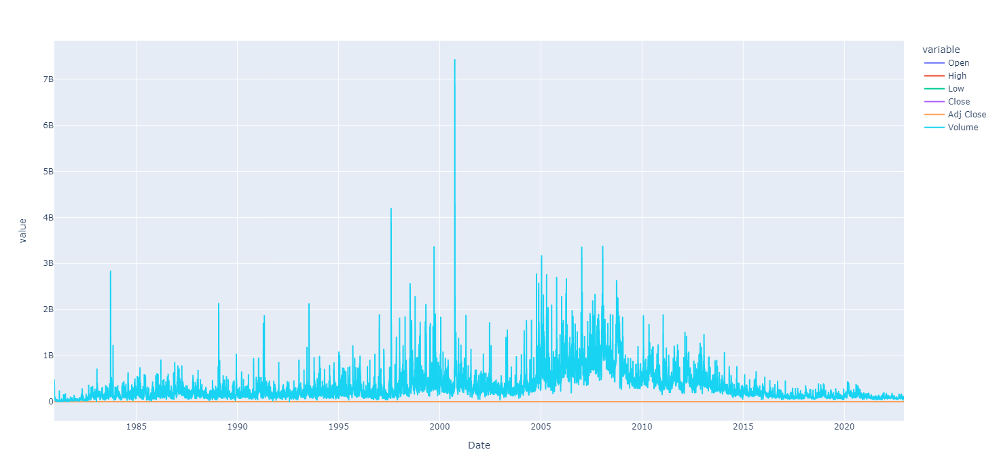

In [154]:
fig = px.line(apple_data, x="Date", y=list(apple_data.columns[1:,]), height=700)

fig.show()

In [113]:
merged_df[merged_df["Standard Deviation"].eq(merged_df["Standard Deviation"].max())]

,index,Standard Deviation,Mean Values
3,(AAPL) Volume,3.190959e+08,2.263570e+08


In [124]:
apple_Stock = final_df[["Date","(AAPL) Volume"]].sort_values(by="Date")
AAPL = apple_Stock[apple_Stock["(AAPL) Volume"] > 0]
AAPL.head()

,Date,(AAPL) Volume
5805,1980-12-12,469033600.0
5806,1980-12-15,175884800.0
5807,1980-12-16,105728000.0
5808,1980-12-17,86441600.0
5809,1980-12-18,73449600.0


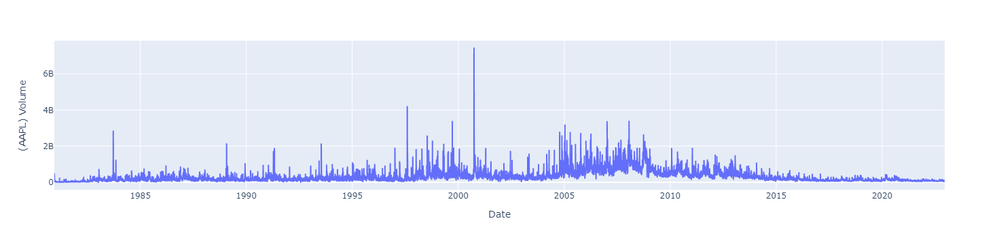

In [125]:
fig = px.line(AAPL, x="Date", y="(AAPL) Volume")

fig.show()

In [75]:
# stock1s = []
# stock2s = []
# corrs = []
# p_values = []
# for stock1 in final_df:
#     for stock2 in final_df:
#         if stock1 != stock2:
#             stock1s.append(stock1)
#             stock2s.append(stock2)
#             corr, p_value = scipy.stats.spearmanr(final_df[stock1], final_df[stock2], nan_policy='omit')
#             corrs.append(corr)
#             p_values.append(p_value)
            
# test_df['Stock_one'] = stock1s
# test_df['Stock_two'] = stock2s
# test_df['Correlation'] = corrs
# test_df['p_value'] = p_values
# test_df.head()

In [27]:
corr.shape

(503, 503)

In [54]:
name = str(path_list[0]).split("\\")[-1].split('.')[0]
stock_name = f'({name}) Volume'
stock_name

'(A) Volume'

In [65]:

data = pd.read_csv(path_list[0], parse_dates=["Date"])
data.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,1999-11-18,32.546494,35.765381,28.612303,31.473534,26.929766,62546380.0
1,1999-11-19,30.713518,30.758226,28.478184,28.880545,24.711121,15234146.0
2,1999-11-22,29.551144,31.473534,28.657009,31.473534,26.929766,6577870.0
3,1999-11-23,30.400572,31.205294,28.612303,28.612303,24.481598,5975611.0
4,1999-11-24,28.701717,29.998213,28.612303,29.372318,25.131897,4843231.0


In [61]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5805 entries, 0 to 5804
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Date       5805 non-null   datetime64[ns]
 1   Open       5805 non-null   float64       
 2   High       5805 non-null   float64       
 3   Low        5805 non-null   float64       
 4   Close      5805 non-null   float64       
 5   Adj Close  5805 non-null   float64       
 6   Volume     5805 non-null   float64       
dtypes: datetime64[ns](1), float64(6)
memory usage: 317.6 KB


In [66]:
data.set_index("Date")

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
1999-11-18,32.546494,35.765381,28.612303,31.473534,26.929766,62546380.0
1999-11-19,30.713518,30.758226,28.478184,28.880545,24.711121,15234146.0
1999-11-22,29.551144,31.473534,28.657009,31.473534,26.929766,6577870.0
1999-11-23,30.400572,31.205294,28.612303,28.612303,24.481598,5975611.0
1999-11-24,28.701717,29.998213,28.612303,29.372318,25.131897,4843231.0
...,...,...,...,...,...,...
2022-12-07,151.229996,154.350006,151.130005,153.729996,153.729996,1011100.0
2022-12-08,154.419998,156.990005,153.479996,156.279999,156.279999,1289900.0
2022-12-09,155.669998,156.699997,152.679993,152.949997,152.949997,1020200.0


In [73]:
data["Volume"].describe()

count    5.805000e+03
mean     3.455505e+06
std      2.433585e+06
min      2.719000e+05
25%      1.945177e+06
50%      2.954254e+06
75%      4.284311e+06
max      6.254638e+07
Name: Volume, dtype: float64

In [74]:
data["Volume"].mean()

3455505.457192076

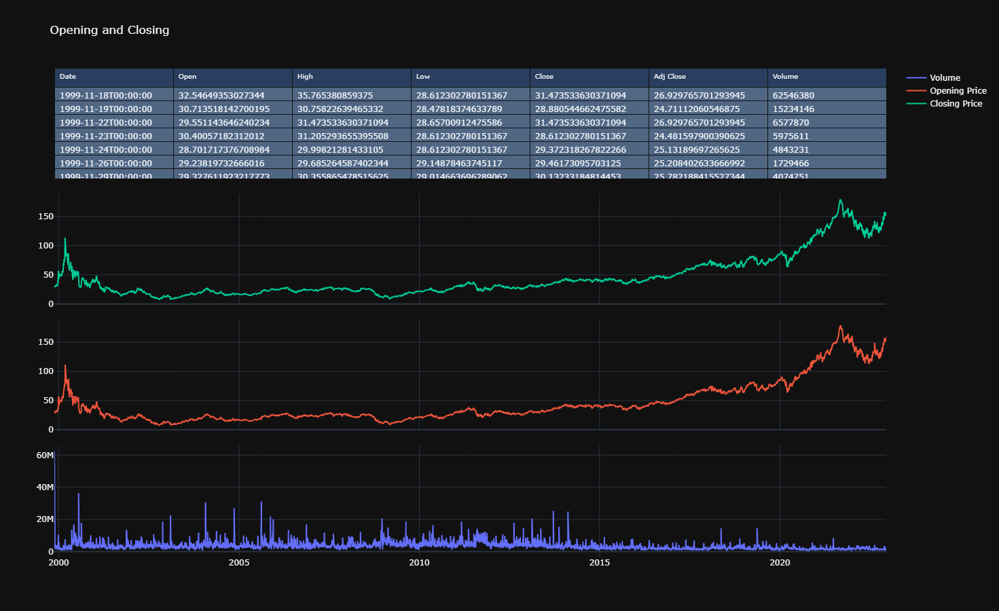

In [67]:
fig = make_subplots(
    rows=4, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{"type":"table"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}]]
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Volume,
        mode="lines",
        name="Volume",
    ),
    row=4, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Open,
        mode="lines",
        name="Opening Price",
    ),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Close,
        mode="lines",
        name="Closing Price",
    ),
    row=2, col=1
)

fig.add_trace(
    go.Table(
        header=dict(
            values=["Date", "Open", "High",
                    "Low", "Close", "Adj Close",
                    "Volume"],
            font=dict(size=10),
            align="left"
        ),
        cells=dict(
            values=[data[k].tolist() for k in data.columns],
            align = "left")
    ),
    row=1, col=1
)

fig.update_layout(
    height=900,
    showlegend=True,
    title_text="Opening and Closing", template="plotly_dark",
)

fig.show()

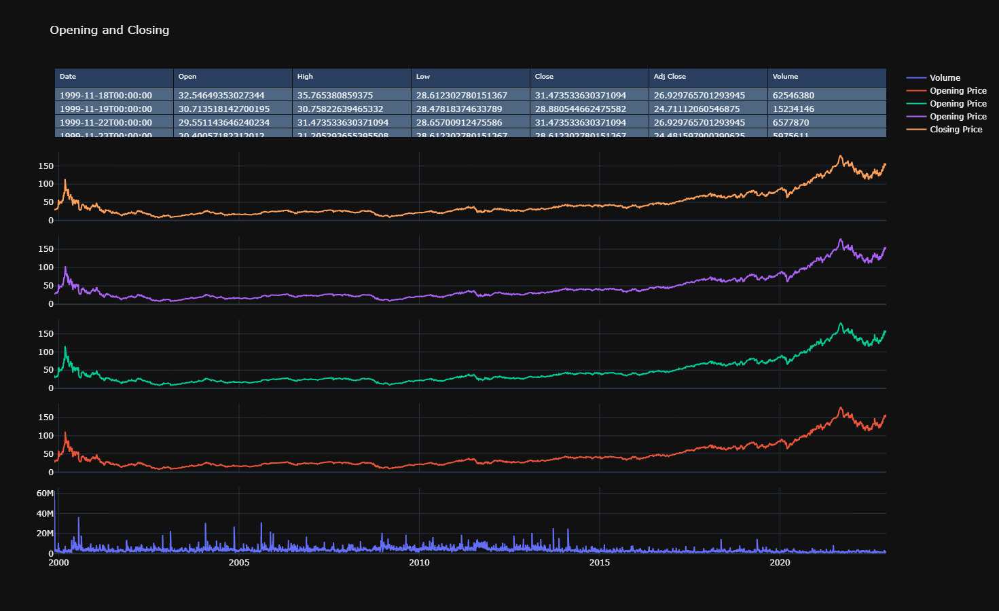

In [70]:
fig = make_subplots(
    rows=6, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{"type":"table"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}],
           [{"type":"scatter"}]]
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Volume,
        mode="lines",
        name="Volume",
    ),
    row=6, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Open,
        mode="lines",
        name="Opening Price",
    ),
    row=5, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.High,
        mode="lines",
        name="Opening Price",
    ),
    row=4, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Low,
        mode="lines",
        name="Opening Price",
    ),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(
        x=data.Date,
        y=data.Close,
        mode="lines",
        name="Closing Price",
    ),
    row=2, col=1
)

fig.add_trace(
    go.Table(
        header=dict(
            values=["Date", "Open", "High",
                    "Low", "Close", "Adj Close",
                    "Volume"],
            font=dict(size=10),
            align="left"
        ),
        cells=dict(
            values=[data[k].tolist() for k in data.columns],
            align = "left")
    ),
    row=1, col=1
)

fig.update_layout(
    height=900,
    showlegend=True,
    title_text="Opening and Closing", template="plotly_dark",
)

In [ ]:
fig = px.line(year_1999_to_2009, x=year_1999_to_2009.Date, y=["Open", "Close", "High", "Low"], height=700, template="plotly_dark")

fig.show()